[![Open In Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/github/DCDPUAEM/DCDP/blob/main/02%20An%C3%A1lisis%20Estad%C3%ADstico/notebooks/extra/BI/Brief_Exercise2_CGS_DT_RF_XGB.ipynb)

In [ ]:
# @title Setup
from google.colab import auth
from google.cloud import bigquery
from google.colab import data_table

project = 'ucamp-v2' # Project ID inserted based on the query results selected to explore
location = 'US' # Location inserted based on the query results selected to explore
client = bigquery.Client(project=project, location=location)
data_table.enable_dataframe_formatter()
auth.authenticate_user()

## Reference SQL syntax from the original job
Use the ```jobs.query```
[method](https://cloud.google.com/bigquery/docs/reference/rest/v2/jobs/query) to
return the SQL syntax from the job. This can be copied from the output cell
below to edit the query now or in the future. Alternatively, you can use
[this link](https://console.cloud.google.com/bigquery?j=ucamp-v2:US:bquxjob_73103421_18cfb11bd6e)
back to BigQuery to edit the query within the BigQuery user interface.

In [ ]:
# Running this code will display the query used to generate your previous job

job = client.get_job('bquxjob_73103421_18cfb11bd6e') # Job ID inserted based on the query results selected to explore
print(job.query)

-- Muestra aleatoria de 10,000 registros y selección de columnas
WITH sample_data AS (
  SELECT
    state_number,
    county,
    city,
    day_of_week,
    EXTRACT(HOUR FROM timestamp_of_crash) AS hour,
    latitude,
    longitude,
    number_of_fatalities
  FROM
    `bigquery-public-data.nhtsa_traffic_fatalities.accident_2015`
  WHERE
    RAND() < 10000 / (SELECT COUNT(*) FROM `bigquery-public-data.nhtsa_traffic_fatalities.accident_2015`)
)

SELECT
  *
FROM
  sample_data



# Result set loaded from BigQuery job as a DataFrame
Query results are referenced from the Job ID ran from BigQuery and the query
does not need to be re-run to explore results. The ```to_dataframe```
[method](https://googleapis.dev/python/bigquery/latest/generated/google.cloud.bigquery.job.QueryJob.html#google.cloud.bigquery.job.QueryJob.to_dataframe)
downloads the results to a Pandas DataFrame by using the BigQuery Storage API.

To edit query syntax, you can do so from the BigQuery SQL editor or in the
```Optional:``` sections below.

In [ ]:
# Running this code will read results from your previous job

job = client.get_job('bquxjob_73103421_18cfb11bd6e') # Job ID inserted based on the query results selected to explore
results = job.to_dataframe()
results

,state_number,county,city,day_of_week,hour,latitude,longitude,number_of_fatalities
0,56,1,0,2,7,41.435111,-105.904492,2
1,2,20,850,6,12,60.821764,-148.976003,1
2,38,101,0,2,8,48.096069,-101.296150,1
3,38,79,0,6,19,48.860031,-99.766639,1
4,38,95,0,5,0,48.555111,-99.144339,1
...,...,...,...,...,...,...,...,...
10058,55,105,2320,6,10,42.711239,-89.030900,1
10059,55,79,3100,3,16,43.104906,-88.053125,1
10060,55,59,2400,2,19,42.572353,-87.855256,1
10061,55,25,0,1,12,43.173244,-89.106742,1


## Show descriptive statistics using describe()
Use the ```pandas DataFrame.describe()```
[method](https://pandas.pydata.org/docs/reference/api/pandas.DataFrame.describe.html)
to generate descriptive statistics. Descriptive statistics include those that
summarize the central tendency, dispersion and shape of a dataset’s
distribution, excluding ```NaN``` values. You may also use other Python methods
to interact with your data.

In [ ]:
results.describe()

,state_number,county,city,day_of_week,hour,latitude,longitude,number_of_fatalities
count,10063.0,10063.0,10063.0,10063.0,10063.0,10063.000000,10063.000000,10063.0
mean,27.619597,90.640068,1191.085362,4.107125,12.632316,36.882745,-88.043166,1.09053
std,16.319429,94.465499,1873.928155,2.096663,6.96083,6.510025,69.650817,0.347997
min,1.0,1.0,0.0,1.0,0.0,19.597711,-158.111867,1.0
25%,12.0,31.0,0.0,2.0,7.0,33.137297,-98.322719,1.0
50%,28.0,71.0,0.0,4.0,14.0,36.348211,-87.718011,1.0
75%,42.0,115.0,1952.0,6.0,19.0,40.647253,-81.398081,1.0
max,56.0,999.0,9999.0,7.0,23.0,99.999900,999.999900,6.0


In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.tree import DecisionTreeClassifier
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Leer los datos desde BigQuery o utilizar el DataFrame resultante de la consulta anterior
df = results.copy()

# Asegurarse de que las etiquetas están en el rango esperado para XGBoost
df['number_of_fatalities'] -= 1

# Definir las características (X) y la variable objetivo (y)
X = df.drop("number_of_fatalities", axis=1)
y = df["number_of_fatalities"]

# Dividir los datos en conjuntos de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# ------------------------------
# Modelo de Decision Tree (DT)
# ------------------------------
dt_model = DecisionTreeClassifier(random_state=42)
dt_model.fit(X_train, y_train)
dt_predictions = dt_model.predict(X_test)

# Evaluar el modelo DT
print("Decision Tree Classifier:")
print("Accuracy:", accuracy_score(y_test, dt_predictions))
print("Confusion Matrix:\n", confusion_matrix(y_test, dt_predictions))
print("Classification Report:\n", classification_report(y_test, dt_predictions))

# ------------------------------
# Modelo de Random Forest (RF)
# ------------------------------
rf_model = RandomForestClassifier(random_state=42)
rf_model.fit(X_train, y_train)
rf_predictions = rf_model.predict(X_test)

# Evaluar el modelo RF
print("\nRandom Forest Classifier:")
print("Accuracy:", accuracy_score(y_test, rf_predictions))
print("Confusion Matrix:\n", confusion_matrix(y_test, rf_predictions))
print("Classification Report:\n", classification_report(y_test, rf_predictions))

# ------------------------------
# Modelo de XGBoost (XGB)
# ------------------------------
xgb_model = XGBClassifier(random_state=42)
xgb_model.fit(X_train, y_train)
xgb_predictions = xgb_model.predict(X_test)

# Evaluar el modelo XGB
print("\nXGBoost Classifier:")
print("Accuracy:", accuracy_score(y_test, xgb_predictions))
print("Confusion Matrix:\n", confusion_matrix(y_test, xgb_predictions))
print("Classification Report:\n", classification_report(y_test, xgb_predictions))


Decision Tree Classifier:
Accuracy: 0.8479880774962743
Confusion Matrix:
 [[1685  148   24   10    1]
 [  95   21    4    0    0]
 [  16    4    1    0    0]
 [   4    0    0    0    0]
 [   0    0    0    0    0]]
Classification Report:
               precision    recall  f1-score   support

         0.0       0.94      0.90      0.92      1868
         1.0       0.12      0.17      0.14       120
         2.0       0.03      0.05      0.04        21
         3.0       0.00      0.00      0.00         4
         5.0       0.00      0.00      0.00         0

    accuracy                           0.85      2013
   macro avg       0.22      0.22      0.22      2013
weighted avg       0.88      0.85      0.86      2013



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



Random Forest Classifier:
Accuracy: 0.9254843517138599
Confusion Matrix:
 [[1862    5    1    0]
 [ 119    1    0    0]
 [  21    0    0    0]
 [   4    0    0    0]]
Classification Report:
               precision    recall  f1-score   support

         0.0       0.93      1.00      0.96      1868
         1.0       0.17      0.01      0.02       120
         2.0       0.00      0.00      0.00        21
         3.0       0.00      0.00      0.00         4

    accuracy                           0.93      2013
   macro avg       0.27      0.25      0.24      2013
weighted avg       0.87      0.93      0.89      2013



/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))



XGBoost Classifier:
Accuracy: 0.9225037257824144
Confusion Matrix:
 [[1856    9    1    2]
 [ 119    1    0    0]
 [  21    0    0    0]
 [   4    0    0    0]]
Classification Report:
               precision    recall  f1-score   support

         0.0       0.93      0.99      0.96      1868
         1.0       0.10      0.01      0.02       120
         2.0       0.00      0.00      0.00        21
         3.0       0.00      0.00      0.00         4

    accuracy                           0.92      2013
   macro avg       0.26      0.25      0.24      2013
weighted avg       0.87      0.92      0.89      2013



Análisis:

    Decision Tree: Tiene una precisión decente para la clase mayoritaria (0.0), pero no funciona bien para las clases minoritarias.
    Random Forest: Mejora significativamente en la clasificación de la clase mayoritaria y tiene una precisión aceptable para las clases minoritarias.
    XGBoost: Similar al Random Forest en términos de precisión, pero con resultados ligeramente peores.

Recuerda que estos resultados son una evaluación inicial y pueden mejorarse ajustando hiperparámetros, realizando una ingeniería de características más avanzada o considerando técnicas de manejo de clases desbalanceadas si es necesario.

Head of the dataset:
   state_number  county  city  day_of_week  hour   latitude   longitude  \
0            56       1     0            2     7  41.435111 -105.904492   
1             2      20   850            6    12  60.821764 -148.976003   
2            38     101     0            2     8  48.096069 -101.296150   
3            38      79     0            6    19  48.860031  -99.766639   
4            38      95     0            5     0  48.555111  -99.144339   

   number_of_fatalities  
0                     2  
1                     1  
2                     1  
3                     1  
4                     1  

Summary statistics:
       state_number     county         city  day_of_week       hour  \
count       10063.0    10063.0      10063.0      10063.0    10063.0   
mean      27.619597  90.640068  1191.085362     4.107125  12.632316   
std       16.319429  94.465499  1873.928155     2.096663    6.96083   
min             1.0        1.0          0.0          1.0        0.0

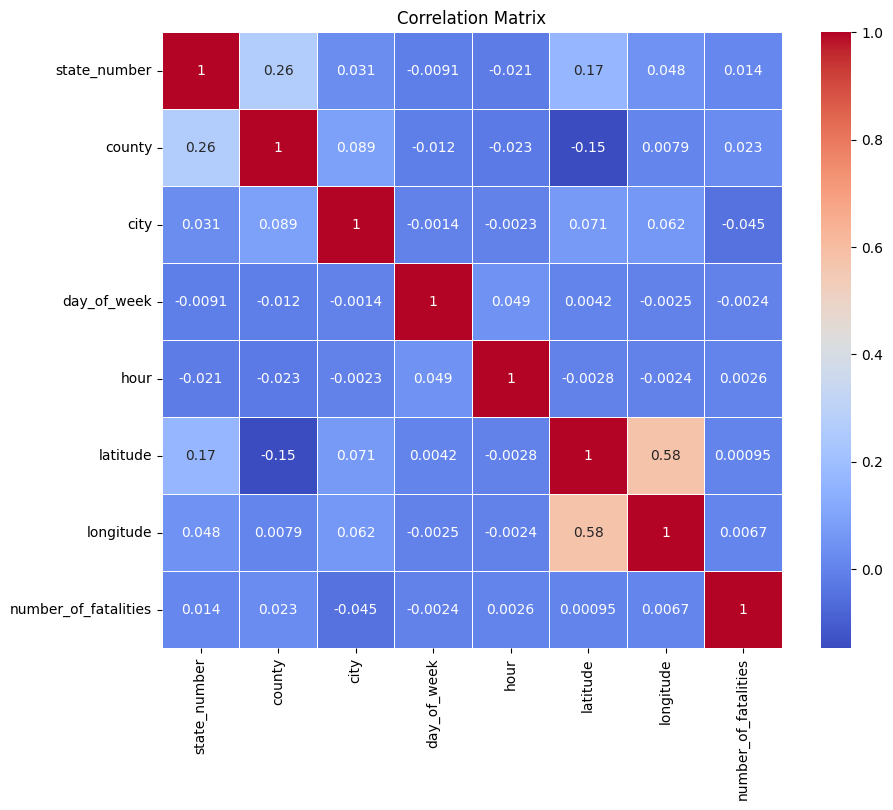

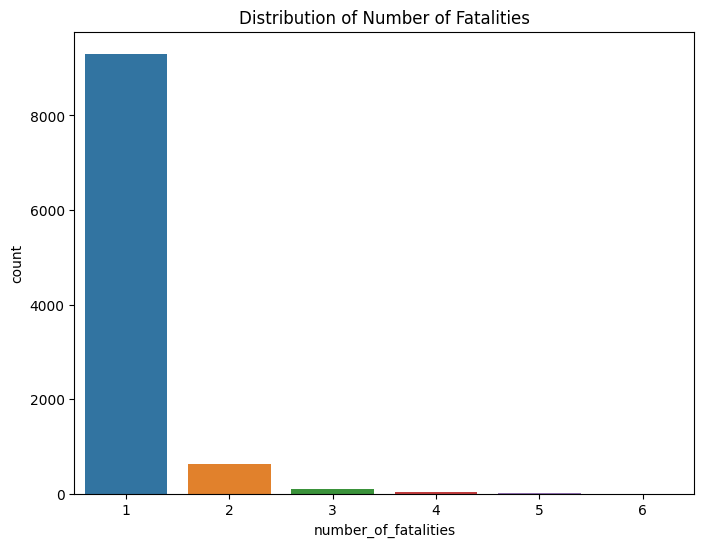

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import folium

# Assuming 'results' is your DataFrame from BigQuery
df = results.copy()

# Visualize the first few rows of the dataset
print("Head of the dataset:")
print(df.head())

# Summary statistics for numerical variables
print("\nSummary statistics:")
print(df.describe())

# Information about data types and the existence of missing values
print("\nData Info:")
print(df.info())

# Correlation matrix heatmap
correlation_matrix = df.corr()
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap="coolwarm", linewidths=0.5)
plt.title("Correlation Matrix")
plt.show()

# Distribution of the variable 'number_of_fatalities'
plt.figure(figsize=(8, 6))
sns.countplot(x="number_of_fatalities", data=df)
plt.title("Distribution of Number of Fatalities")
plt.show()

# Map with the mean of latitude and longitude
mean_latitude = df['latitude'].mean()
mean_longitude = df['longitude'].mean()

map_center = [mean_latitude, mean_longitude]
my_map = folium.Map(location=map_center, zoom_start=10)

# Add a marker for the mean location
folium.Marker(location=map_center, popup='Mean Location', icon=folium.Icon(color='red')).add_to(my_map)

# Display the map
my_map


In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import folium

# Assuming 'results' is your DataFrame from BigQuery
df = results.copy()

# Map with the mean of latitude and longitude
mean_latitude = df['latitude'].mean()
mean_longitude = df['longitude'].mean()

map_center = [mean_latitude, mean_longitude]
my_map = folium.Map(location=map_center, zoom_start=10)

# Add a marker for the mean location
folium.Marker(location=map_center, popup='Mean Location', icon=folium.Icon(color='red')).add_to(my_map)

# Add circle markers for each data point with size proportional to the number of fatalities
for index, row in df.iterrows():
    location = [row['latitude'], row['longitude']]
    fatalities = row['number_of_fatalities']

    # Adjust the radius multiplier as needed for a better visualization
    radius_multiplier = 5
    radius = fatalities * radius_multiplier

    folium.CircleMarker(location=location, radius=radius, color='blue', fill=True, fill_color='blue', fill_opacity=0.6,
                        popup=f'Fatalities: {fatalities}').add_to(my_map)

# Display the map
my_map
